In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import os
import time

No corners detected in : camera_cal/calibration5.jpg
No corners detected in : camera_cal/calibration4.jpg
No corners detected in : camera_cal/calibration1.jpg


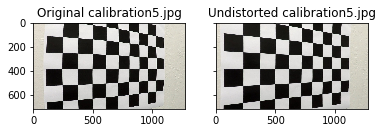

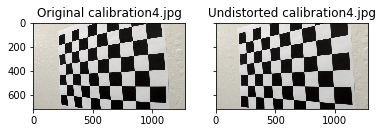

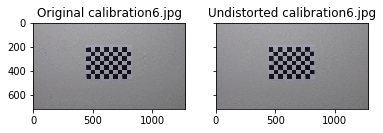

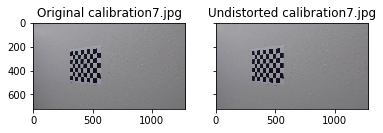

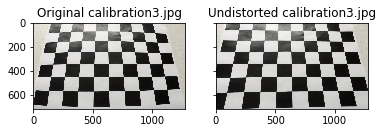

...

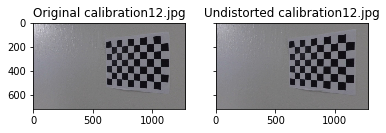

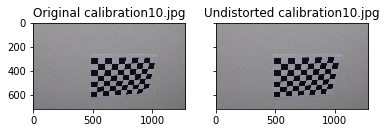

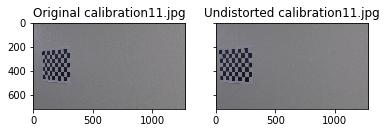

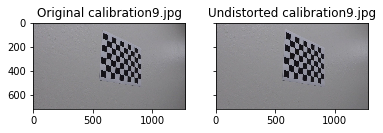

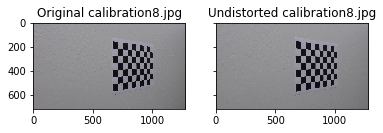

In [2]:
### Calibrate the camera
########################

OUTPUT_FOLDER = 'output_images'

def create_dir(dir):
    if not dir in os.listdir(OUTPUT_FOLDER):
        os.mkdir(os.path.join(OUTPUT_FOLDER, dir))

def load_image(img_path):
    return mpimg.imread(img_path)

def save_image(img, filename, foldername):
    create_dir(os.path.join(foldername))
#     print("Saving " + filename + " to " + foldername)
    plt.imsave(os.path.join(os.getcwd(), OUTPUT_FOLDER, foldername, filename), img)

nx = 9
ny = 6

# 1. Folder to save calibration images with corners drawn
camera_cal_corners_output_directory = 'camera_cal_corners_output'
create_dir(camera_cal_corners_output_directory)
# 2. Folder to store undistorted images with corners drawn
camera_cal_undistort_output_directory = 'camera_cal_undistort_output'
create_dir(camera_cal_undistort_output_directory)


objpoints = []
imgpoints = []

objp = np.zeros((nx*ny, 3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1, 2)

images = glob.glob('camera_cal/*.jpg')
for cal_img_path in images:
    cal_img = mpimg.imread(cal_img_path)
    cal_gray = cv2.cvtColor(cal_img, cv2.COLOR_RGB2GRAY)

    ret, corners = cv2.findChessboardCorners(cal_gray, (nx, ny), None)    
    
    if ret==True:
        imgpoints.append(corners)
        objpoints.append(objp)
        cal_img = cv2.drawChessboardCorners(cal_img, (nx, ny), corners, ret)
        save_image(cal_img, os.path.basename(cal_img_path), camera_cal_corners_output_directory)
    else:
        print("No corners detected in :", cal_img_path)
        

img_array = []
title_array = []
for i in range(len(images)):
    cal_img_path = images[i]
    cal_img = load_image(cal_img_path)
    cal_gray = cv2.cvtColor(cal_img, cv2.COLOR_BGR2GRAY)
    
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, cal_gray.shape[::-1], None, None)
    # Check the results of calibration by undistorting images
    undistorted_img = cv2.undistort(cal_img, mtx, dist, None, mtx)
    undistorted_img_path = os.path.join(camera_cal_undistort_output_directory, os.path.basename(cal_img_path))
    save_image(undistorted_img, os.path.basename(cal_img_path), camera_cal_undistort_output_directory)
    
    f, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
    ax1.imshow(cal_img)
    ax1.set_title("Original " + os.path.basename(cal_img_path))
    ax2.imshow(undistorted_img)
    ax2.set_title("Undistorted " + os.path.basename(undistorted_img_path))


test_images/test6.jpg
test_images/test5.jpg
test_images/test4.jpg
test_images/test1.jpg
test_images/test3.jpg
test_images/test2.jpg
test_images/straight_lines2.jpg
test_images/straight_lines1.jpg


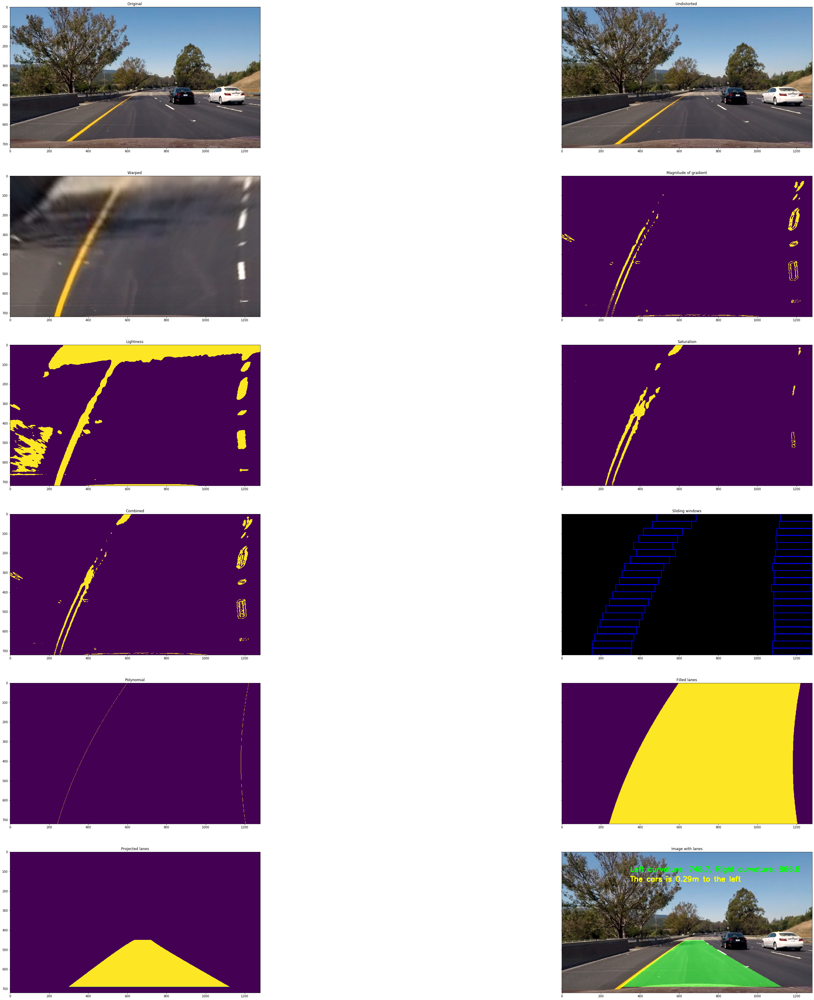

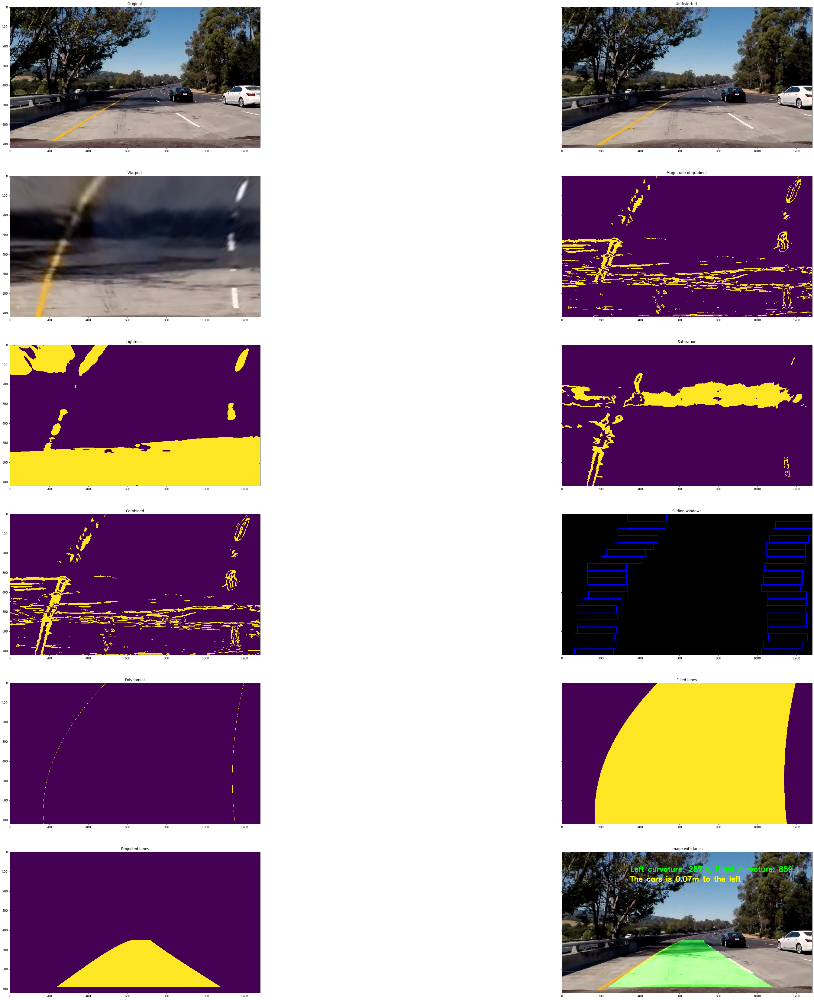

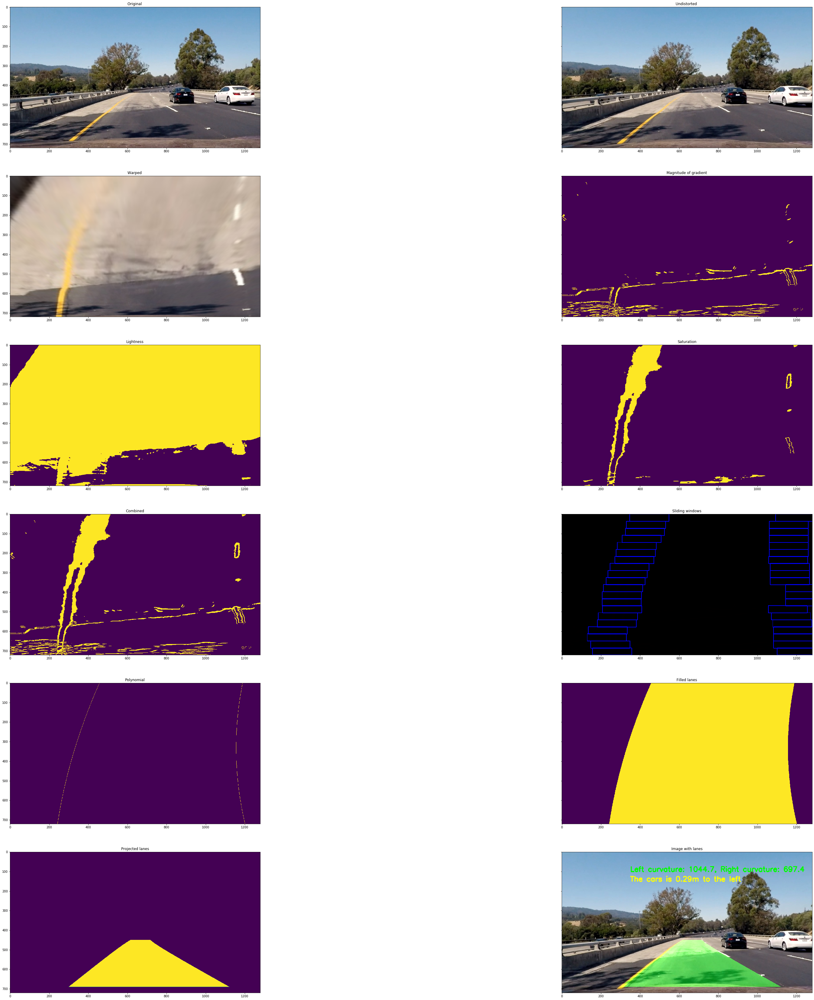

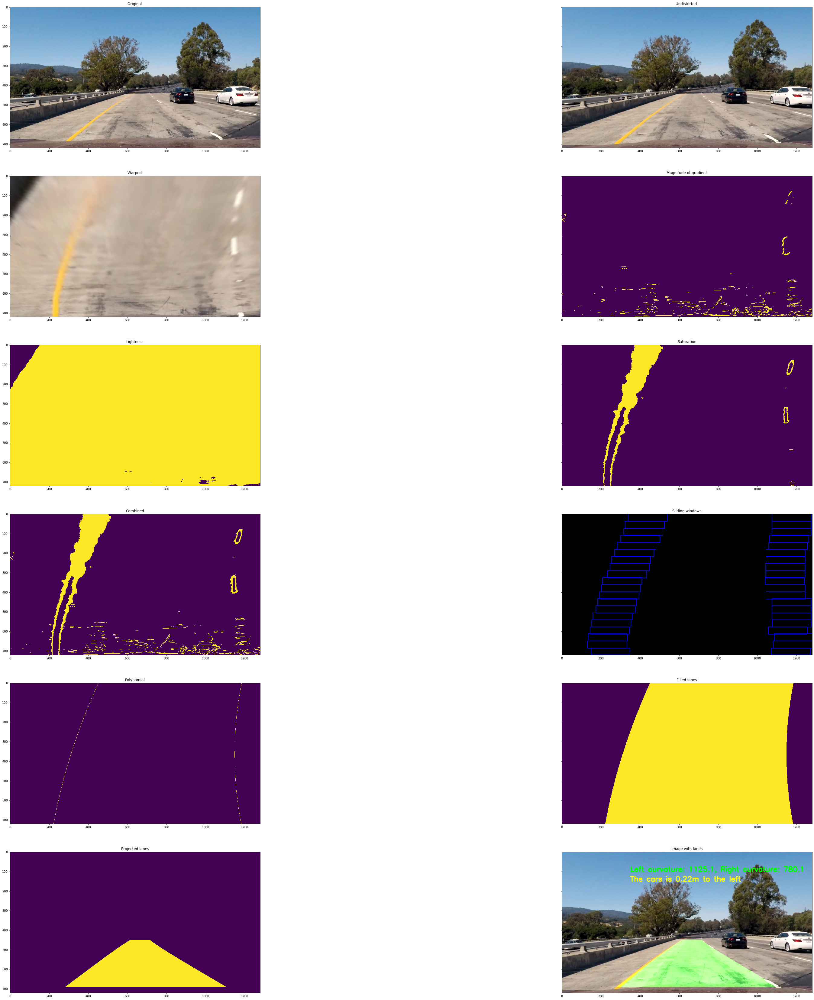

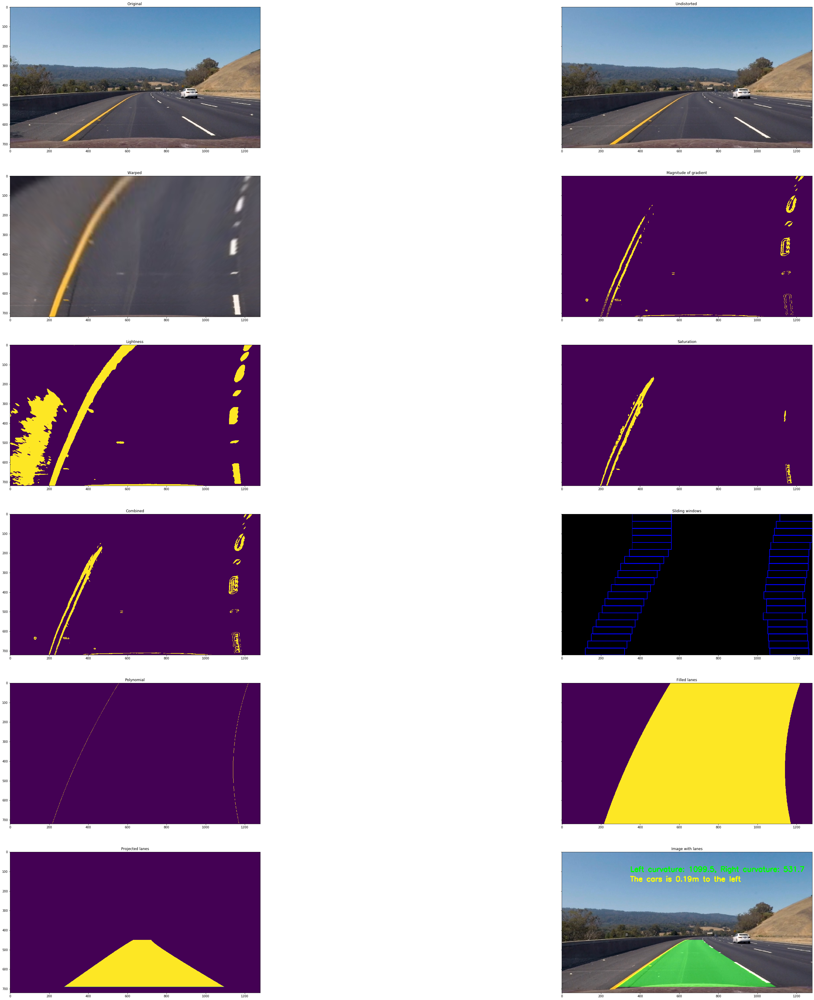

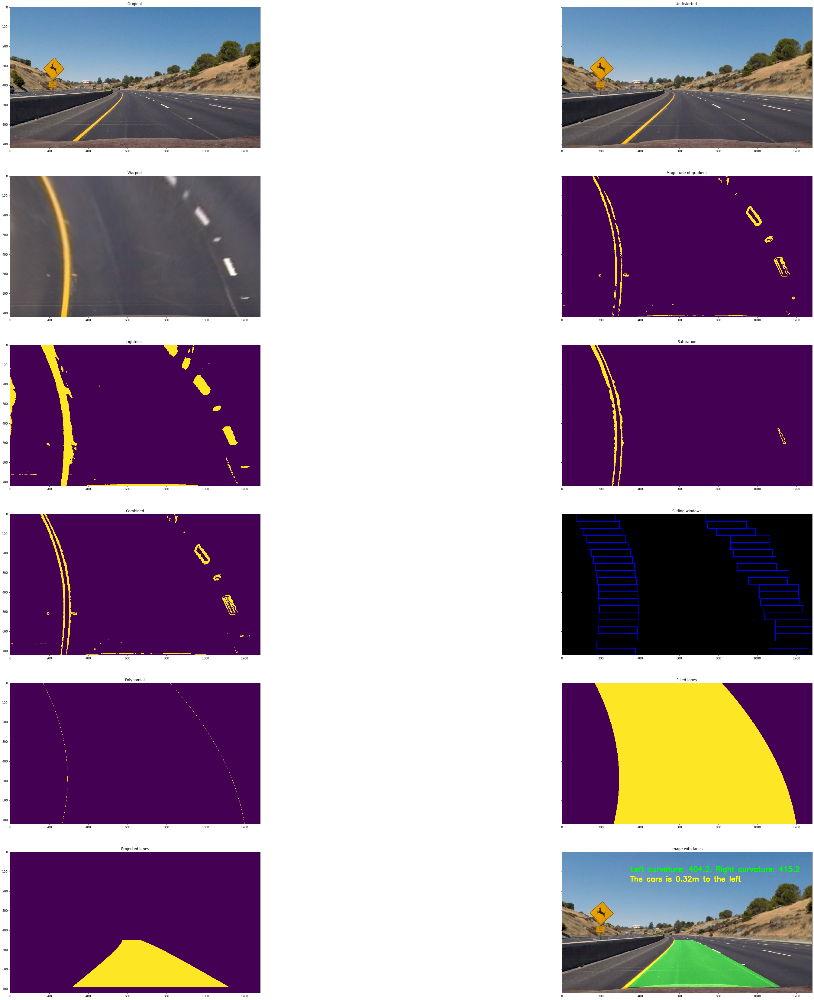

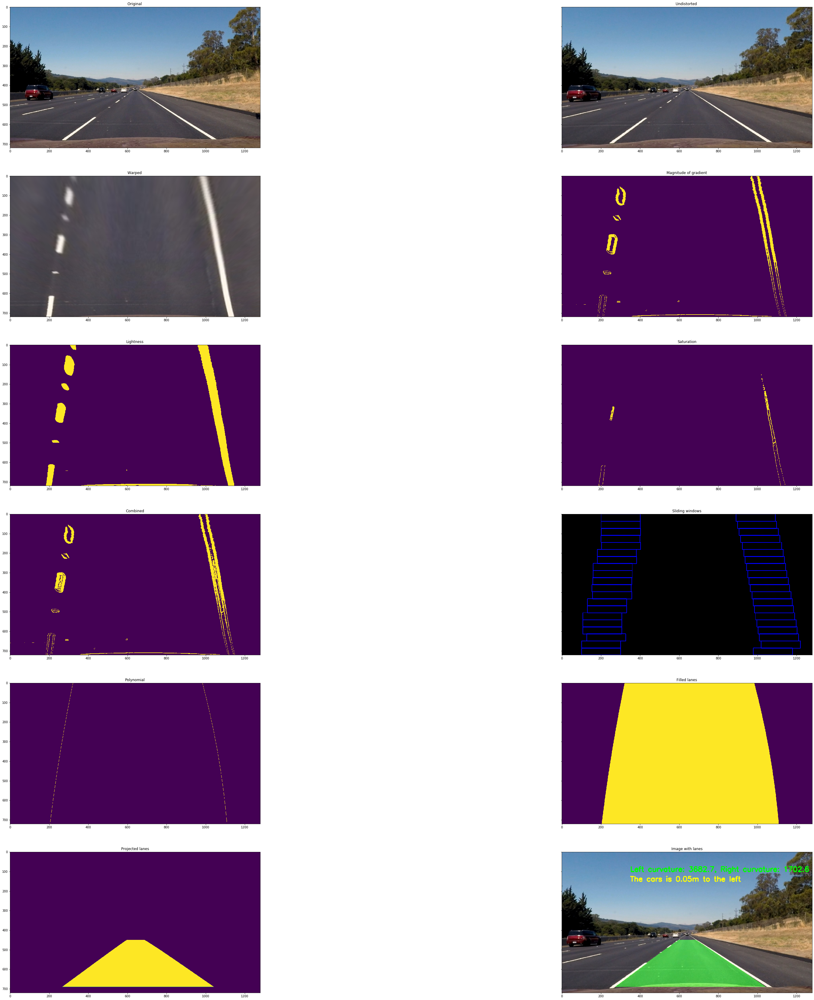

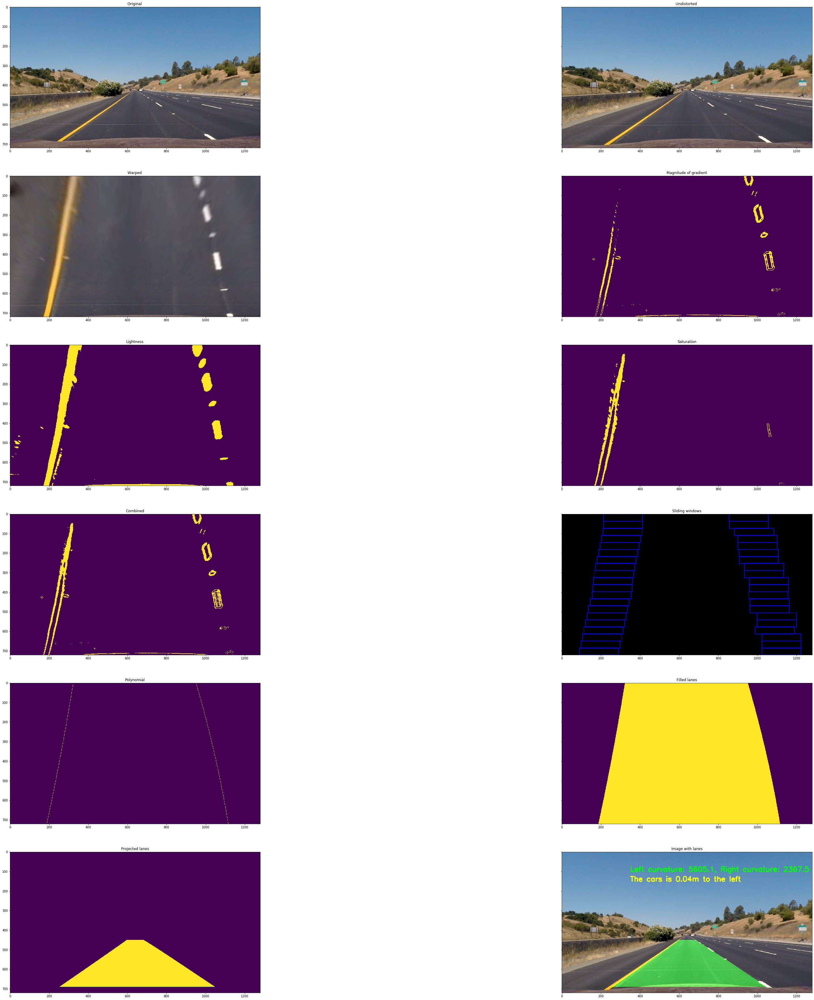

In [24]:
def undistort_image(img):
    return cv2.undistort(img, mtx, dist, None, mtx)

def show_images_in_row(img_array, title_array, cols=2, rows=1, size_in_inches=(60,60)):
    assert len(img_array) == len(title_array)
    assert cols*rows >= len(img_array)

    f, axes = plt.subplots(rows, cols, sharey=True)
    f.set_size_inches(size_in_inches)
    f.size = 50
    for i in range(len(axes)):
        for j in range(len(axes[0])):
            index = i*cols+j
            if index>=len(img_array):
                break
            axes[i,j].set_title(title_array[index])
            try:
                axes[i,j].imshow(img_array[index])
            except:
                axes[i,j].plot(img_array[index])
    

def transformation_points(img):
    # Transform
    shape = img.shape
    xmax = shape[1]
    ymax = shape[0]
    offset = 90
    left_top= (xmax//2-offset, ymax//2+offset)
    right_top= (xmax//2+offset, ymax//2+offset)
    left_bottom= (0+offset, ymax-30)
    right_bottom= (xmax-offset,ymax-30)

    src_points = np.float32([left_top, right_top, right_bottom, left_bottom])
    dst_points = np.float32([(0, 0), (xmax, 0), (xmax, ymax), (0, ymax)])
    return src_points, dst_points
    
    
def get_birds_eye_view_lanes(img, src_points, dst_points):
    shape = img.shape
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (shape[1], shape[0]), flags=cv2.INTER_LINEAR)
    return warped_img

def project_lanes_on_road(img_mask, src_points, dst_points):
    shape = img_mask.shape
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    projected_mask = cv2.warpPerspective(img_mask, M, (shape[1], shape[0]), flags=cv2.INTER_LINEAR)
    return projected_mask


def gradient_magnitude_mask(img, blur=False, blur_kernel=(3,3), thresh_min=30, thresh_max=100):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.medianBlur(gray, 5)

    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1) # Take the derivative in y
    abs_sobely = np.absolute(sobely)

    mag = np.absolute(np.sqrt(np.square(sobelx) + np.square(sobely)))
    mag = np.uint8(255*mag/np.max(mag), dtype=np.float32)
    mag_binary = np.zeros_like(mag, dtype=np.float32)
    mag_binary[(mag >= thresh_min) & (mag <= thresh_max)] = 1
    return mag_binary

def hls_channel_mask(img, channel_id, thresh_min, thresh_max):
    assert (channel_id >= 0) and(channel_id < 3)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    channel = cv2.split(hls)[channel_id]
    binary_mask = np.zeros_like(channel, dtype=np.float32)
    binary_mask[(channel >= thresh_min) & (channel <= thresh_max)] = 1
    return binary_mask


def sliding_windows(img_mask, histogram):
    # Get midpoints of sliding window
    midpoint = histogram.shape[0]//2
    leftx = np.argmax(histogram[:midpoint])
    rightx = np.argmax(histogram[midpoint:]) + midpoint
    n_windows = 20
    xmax = img_mask.shape[1]
    ymax = img_mask.shape[0]
    # Set the sliding window
    window_w = 100
    window_h = ymax//n_windows

    nonzero = img_mask.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    nwindows = ymax//window_h
    leftx_current = leftx
    rightx_current = rightx
    bottom_current = ymax
    top_current = ymax-window_h

    left_lane_indices = []
    right_lane_indices = []

    out_img = np.dstack((img_mask, np.zeros_like(img_mask), np.zeros_like(img_mask)))
    minpix = 10

    for i in range(nwindows):
        leftx_low = leftx_current - window_w
        leftx_high = leftx_current + window_w
        rightx_low = rightx_current - window_w
        rightx_high = rightx_current + window_w
        y_low = top_current
        y_high = bottom_current

        good_left_indices = ((nonzeroy>=y_low) & (nonzeroy<=y_high) & (nonzerox >= leftx_low) & (nonzerox <= leftx_high)).nonzero()[0]
        good_right_indices = ((nonzeroy>=y_low) & (nonzeroy<=y_high) & (nonzerox >= rightx_low) & (nonzerox <= rightx_high)).nonzero()[0]

        left_lane_indices.append(good_left_indices)
        right_lane_indices.append(good_right_indices)

        if(len(good_left_indices) > minpix):
            leftx_current = np.int(np.mean(nonzerox[good_left_indices]))
        if(len(good_right_indices) > minpix):
            rightx_current = np.int(np.mean(nonzerox[good_right_indices]))

        cv2.rectangle(out_img,(leftx_current-window_w, y_high), (leftx_current+window_w, y_low), (0, 0, 255), 2)
        cv2.rectangle(out_img,(rightx_current-window_w, y_high), (rightx_current+window_w, y_low), (0, 0, 255), 2)


        bottom_current = top_current+1
        top_current = top_current-window_h


    left_lane_indices = np.concatenate(left_lane_indices)
    right_lane_indices = np.concatenate(right_lane_indices)

    leftx = nonzerox[left_lane_indices]
    lefty = nonzeroy[left_lane_indices]

    rightx = nonzerox[right_lane_indices]
    righty = nonzeroy[right_lane_indices]
    del left_lane_indices
    del right_lane_indices
    del good_left_indices
    del good_right_indices

    return leftx, lefty, rightx, righty, out_img.astype('uint8')


def fit_polynomial_for_warped(leftx, lefty, rightx, righty, img):
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    yaxis_points = np.array(np.linspace(0, img.shape[0]-1, img.shape[0]), dtype=np.int32)
    left_fitx = np.array(left_fit[0]*yaxis_points**2 + left_fit[1]*yaxis_points + left_fit[2], dtype=np.int32)
    right_fitx = np.array(right_fit[0]*yaxis_points**2 + right_fit[1]*yaxis_points + right_fit[2], dtype=np.int32)
    return left_fitx, right_fitx, yaxis_points, left_fit, right_fit
    
def fit_from_prior(left_fitx, right_fitx, yaxis_points, img_mask, margin = 50):
    # Search from prior
    window_img = np.zeros_like(img_mask)
    new_left_fitx = []
    new_right_fitx = []
    for i in range(len(left_fitx)):
        try:
            roi = img_mask[yaxis_points[i],left_fitx[i]-margin:left_fitx[i]+margin+1]
            mean_left_x = left_fitx[i]-margin + int(np.mean(np.where(roi > 0.0)))
            new_left_fitx.append(mean_left_x)
        except:
            new_left_fitx.append(left_fitx[i])
    for i in range(len(right_fitx)):
        try:
            roi = img_mask[yaxis_points[i],right_fitx[i]-margin:right_fitx[i]+margin+1]
            mean_right_x = right_fitx[i]-margin + int(np.mean(np.where(roi > 0.0)))
            new_right_fitx.append(mean_right_x)
        except:
            new_right_fitx.append(right_fitx[i])
    return new_left_fitx, new_right_fitx, yaxis_points
    

def curvature(leftx, rightx, yaxis_points, left_fit, right_fit, ym_per_pix, xm_per_pix):
    left_fit_cr = np.polyfit(yaxis_points*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(yaxis_points*ym_per_pix, rightx*xm_per_pix, 2)
    y_eval = np.max(yaxis_points)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    return left_curverad, right_curverad

def distance_from_center(unwarped_img_mask):
    '''Returns the difference of the lane center with the frame center with a flag if its to the right or not'''
    width = unwarped_img_mask.shape[1]
    frame_center = width//2
    histogram = get_histogram(unwarped_img_mask)
    left_x = histogram.nonzero()[0][0]
    right_x = histogram.nonzero()[0][-1]
    lane_mean = (right_x+left_x)//2
    if lane_mean > frame_center:
        # Lane is to the right, meaning car is to the left
        return lane_mean-frame_center, -1
    else:
        # Lane is to the left, meaning car is to the right
        return frame_center-lane_mean, 1

def draw_lane(poly_img_mask, left_fitx, right_fitx):
    for pt in range(poly_img_mask.shape[0]):
        poly_img_mask[pt][left_fitx[pt]:right_fitx[pt]+1] = 255
        
    return poly_img_mask

def add_lanes_to_img(img, lane_mask):
    rgb_mask = np.dstack((np.zeros_like(lane_mask), lane_mask, np.zeros_like(lane_mask)))
    return cv2.addWeighted(np.array(img, dtype=np.uint8),1.0, np.array(rgb_mask, dtype=np.uint8),0.5,0)

def get_histogram(img):
    shape = img.shape
    lower_third_img = img[int(img.shape[0]*0.7):,:]
    return np.sum(lower_third_img, axis=0)


def lane_drawing_pipeline(img, PREVIOUS_FIT=[], output=False):
    undist_img = undistort_image(img)    
    src_points, dst_points = transformation_points(undist_img)
    warped_img = get_birds_eye_view_lanes(undist_img, src_points, dst_points)
    warped_img = cv2.GaussianBlur(warped_img,( 1, 7),0)
    
    mag_binary = gradient_magnitude_mask(warped_img, blur=True, thresh_min=30, thresh_max=70)
    l_channel = hls_channel_mask(warped_img, 1, 100, 255)
    s_channel = hls_channel_mask(warped_img, 2, 100, 180)
    combined = np.zeros_like(s_channel)
    combined[((s_channel>0) & (l_channel>0)) | (mag_binary>0)] = 1

    sliding_window_img = np.zeros_like(combined)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/900 # meters per pixel in x dimension

    if PREVIOUS_FIT != []:
        new_leftx, new_rightx, yaxis_points = fit_from_prior(PREVIOUS_FIT[0], PREVIOUS_FIT[1], PREVIOUS_FIT[2], combined)
        left_fitx, right_fitx, yaxis_points, left_fit, right_fit = fit_polynomial_for_warped(new_leftx, yaxis_points, new_rightx, yaxis_points, combined)
    else:
        # Get histogram
        histogram = get_histogram(combined)
        leftx, lefty, rightx, righty, sliding_window_img = sliding_windows(combined, histogram)
        left_fitx, right_fitx, yaxis_points, left_fit, right_fit = fit_polynomial_for_warped(leftx, lefty, rightx, righty, combined)
    poly_mask = np.zeros_like(combined)
    for y,x in zip(yaxis_points, left_fitx):
        y = min(y, poly_mask.shape[0]-1)
        x = min(x, poly_mask.shape[1]-1)
        poly_mask[y,x] = 1
    for y,x in zip(yaxis_points, right_fitx):
        y = min(y, poly_mask.shape[0]-1)
        x = min(x, poly_mask.shape[1]-1)
        poly_mask[y,x] = 1
    left_curvature, right_curvature = curvature(left_fitx, right_fitx, yaxis_points, left_fit, right_fit, ym_per_pix, xm_per_pix)
    lanes_img = draw_lane(np.copy(poly_mask), left_fitx, right_fitx)
    unwarped_img_mask = project_lanes_on_road(lanes_img, dst_points, src_points)
    center_distance, to_right = distance_from_center(unwarped_img_mask)
    final_img_with_lanes = add_lanes_to_img(undist_img, unwarped_img_mask)

    
    text = "Left curvature: "+str(round(left_curvature,1))+", Right curvature: "+str(round(right_curvature,1))
    cv2.putText(final_img_with_lanes, text, (350, 100), cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0, 255, 0), thickness=3, lineType=cv2.LINE_AA) 
    text = "The cars is "+str(round(center_distance*xm_per_pix, 2))+"m to the "+("right" if to_right == 1 else "left")
    cv2.putText(final_img_with_lanes, text, (350, 150), cv2.FONT_HERSHEY_SIMPLEX, 1.2, (255, 255, 0), thickness=3, lineType=cv2.LINE_AA) 
    title_array = [
        "Original ",
        "Undistorted ",
        "Warped ",
        "Magnitude of gradient",
        "Lightness",
        "Saturation",
        "Combined",
        "Sliding windows",
        "Polynomial",
        "Filled lanes",
        "Projected lanes",
        "Image with lanes"
    ]
    img_array = [
        img, 
        undist_img, 
        warped_img, 
        mag_binary,
        l_channel,
        s_channel,
        combined,
        sliding_window_img,
        poly_mask,
        lanes_img,
        unwarped_img_mask,
        final_img_with_lanes
    ]
    if output:
        show_images_in_row(img_array, title_array, cols=2, rows=(len(title_array)+1)//2)

    return final_img_with_lanes, [left_fitx, right_fitx, yaxis_points], img_array


# TODO
# 2. Complete the writeup with image links
TEST_IMAGES_DIR = 'test_images'
for test_img_path in glob.glob(TEST_IMAGES_DIR+"/*.jpg"):
    print(test_img_path)
    test_img = load_image(test_img_path)
    final_img_with_lanes, _, img_array= lane_drawing_pipeline(test_img, output=True)
    save_image(img_array[1], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_undistorted")
    save_image(img_array[2], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_warped")
    save_image(img_array[3], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_mag_binary")
    save_image(img_array[4], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_l_channel_binary")
    save_image(img_array[5], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_s_channel_binary")
    save_image(img_array[6], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_final_binary")
    save_image(img_array[7], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_sliding_windows")
    save_image(img_array[8], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_polynomial")
    save_image(img_array[11], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_with_lanes")
    

In [25]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

PREVIOUS_FIT = []
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    global PREVIOUS_FIT
    img_with_lanes, PREVIOUS_FIT, _ = lane_drawing_pipeline(image, PREVIOUS_FIT)
    return img_with_lanes

project_output = 'project_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(project_output, audio=False)

t:   0%|          | 0/1260 [00:00<?, ?it/s, now=None]

Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



Moviepy - Done !
Moviepy - video ready project_video_output.mp4
CPU times: user 5min 44s, sys: 1min 21s, total: 7min 6s
Wall time: 5min 33s
